In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import pypianoroll
import matplotlib.pyplot as plt
import pandas as pd
import glob

In [3]:
from music_generator.models import DivideAndComposeBidirectional
from music_generator.midi import play_pianoroll, plot_pianoroll, create_multitrack

In [4]:
files = glob.glob('../**/*.npz', recursive=True)

In [5]:
multitracks = [pypianoroll.load(fp) for fp in files[0:10]]

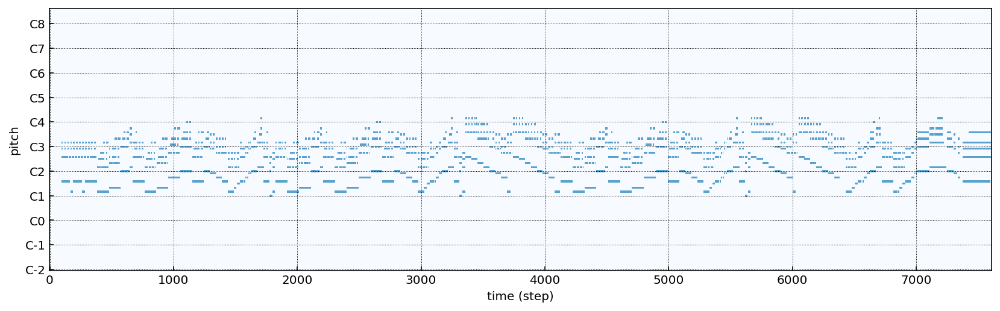

In [24]:
model = DivideAndComposeBidirectional(multitracks[2], 'Piano')

In [25]:
play_pianoroll(model.mtrack, model.track.pianoroll)

In [26]:
model.init_model(quarter_notes_window=8)
model.fit(epochs=200)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
bidirectional_2 (Bidirection (None, 192, 1024)         1972224   
_________________________________________________________________
bidirectional_3 (Bidirection (None, 192, 1024)         4724736   
_________________________________________________________________
dense_2 (Dense)              (None, 192, 256)          262400    
_________________________________________________________________
dense_3 (Dense)              (None, 192, 128)          32896     
Total params: 6,992,256
Trainable params: 6,992,256
Non-trainable params: 0
_________________________________________________________________
Epoch 1/200
1/1 [==============================] - 6s 6s/step - loss: 120.5441 - val_loss: 99.0866
Epoch 2/200
1/1 [==============================] - 2s 2s/step - loss: 98.5102 - val_loss: 286.1189
Epoch 3/200
1/1 [===========================

In [27]:
otherSong = multitracks[5].tracks[1].pianoroll[0:192*2].reshape(2, 192, 128)

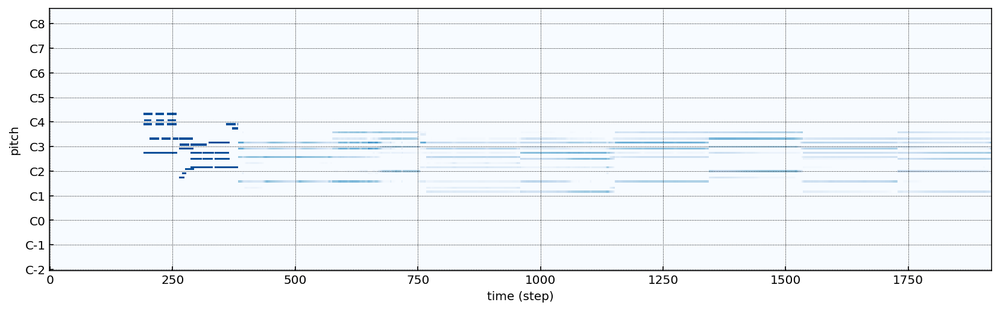

In [28]:
song = model.continueRoll(5, intro_roll=otherSong)
model.plot(song)

In [29]:
model.play(song)